## INDEX


#### Importing Libraries

In [1]:
import numpy as np
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras import preprocessing

import cv2
import matplotlib.pyplot as plt

import glob
import os

import warnings

warnings.filterwarnings("ignore")

Init Plugin
Init Graph Optimizer
Init Kernel


#### Loading Data

In [2]:
directory = "/Users/nilanjansahu/Downloads/MRI Dataset/"


Tr1_orig_path = directory + 'Tr1/'
Tr2_orig_path = directory + 'Tr2/'


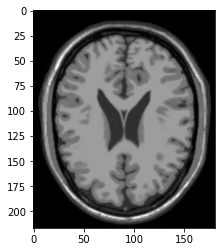

In [3]:
#display Tr1 image
Tr1_images = os.listdir(Tr1_orig_path + 'TrainT1')
Tr1_img = cv2.imread(Tr1_orig_path + 'TrainT1/' + Tr1_images[0])
plt.imshow(Tr1_img)

In [4]:
#shape of Tr1 image
print(Tr1_img.shape)

(217, 181, 3)


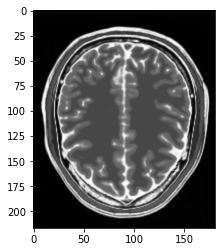

In [5]:
#display Tr2 image
Tr2_images = os.listdir(Tr2_orig_path + 'TrainT2')
Tr2_img = cv2.imread(Tr2_orig_path + 'TrainT2/' + Tr2_images[0])
plt.imshow(Tr2_img)

In [6]:
#shape of Tr2 image
print(Tr2_img.shape)

(217, 181, 3)


In [7]:
img_height = 64
img_width = 64
batch_size = 8

In [8]:
Tr1_paths = tf.io.gfile.glob(Tr1_orig_path + 'TrainT1/' + '*')
Tr2_paths = tf.io.gfile.glob(Tr2_orig_path + 'TrainT2/' + '*')

In [9]:
Tr1_dataset = tf.data.Dataset.from_tensor_slices(Tr1_paths)
Tr2_dataset = tf.data.Dataset.from_tensor_slices(Tr2_paths)

Metal device set to: Apple M1


2021-11-01 15:56:18.318871: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:305] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2021-11-01 15:56:18.319063: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:271] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


In [10]:
def read_image(img_file): 
    image = tf.io.read_file(img_file)
    image = tf.io.decode_jpeg(image, channels=3)
    image = tf.image.resize(image,[64,64])
    image = (image/127.5) -1
    return image

In [11]:
Tr1_dataset = Tr1_dataset.map(read_image).batch(batch_size)
Tr2_dataset = Tr2_dataset.map(read_image).batch(batch_size)

In [12]:
t1 = next(iter(Tr1_dataset))
t1.shape

2021-11-01 15:56:20.067371: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:176] None of the MLIR Optimization Passes are enabled (registered 2)
2021-11-01 15:56:20.067772: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz


TensorShape([8, 64, 64, 3])

#### Model Building

In [13]:
#creation of instance normalization 

class InstanceNormalization(layers.Layer):
    
    def __init__(self,epsilon=1e-5):
        super(InstanceNormalization,self).__init__()
        self.epsilon = epsilon
        
    def build(self, input_shape):
        self.scale = self.add_weight(
            name = 'scale',
            shape = input_shape[-1:],
            initializer=tf.random_normal_initializer(1.0, 0.02),
            trainable=True
        )
        self.offset = self.add_weight(
            name = 'offset',
            shape = input_shape[-1:],
            initializer='zeros',
            trainable=True
        )
        
    def call(self, x):
        mean, variance = tf.nn.moments(x, axes=[1,2], keepdims=True)
        inv = tf.math.rsqrt(variance + self.epsilon)
        normalise = (x - mean)*inv
        return self.scale * normalise + self.offset
    

In [14]:
# Conv layers

def Contraction(filters, size, apply_norm = True):
    initializer = tf.random_normal_initializer(0., 0.02)
    model = keras.Sequential()
    model.add(layers.Conv2D(filters, size, strides=2, padding='same', 
                             kernel_initializer=initializer, use_bias=False))

    
    if apply_norm:
        model.add(InstanceNormalization())
    
    model.add(layers.LeakyReLU())
    return model     

In [15]:
# Conv Transpose layers

def Expansion(filters, size, apply_dropout=True):
    initializer = tf.random_normal_initializer(0., 0.02)
    model = keras.Sequential()
    model.add(layers.Conv2DTranspose(filters, size, strides=2, padding='same',
                                     kernel_initializer=initializer, use_bias=False))
    model.add(InstanceNormalization())
    
    if apply_dropout:
        model.add(layers.Dropout(0.2))
    model.add(layers.ReLU())
    return model

In [138]:
#Creating U-net generator

def unet_generator():
    # image shape is 64,64,3 with batch of 64
    contraction_stack = [
        Contraction(64, 4, False), #output shape 32, 32, 64
        Contraction(128, 4, True), #output shape 16, 16, 128
        Contraction(128, 4, True), #output shape 8, 8, 128
        Contraction(128, 4, True), #output shape 4, 4, 128
        Contraction(128, 4, True), #output shape 2, 2, 128
        Contraction(128, 4, True) #output shape 1, 1, 128
    ]
    
    expansion_stack = [
        Expansion(128, 4, False), #output shape 2, 2, 128
        Expansion(128, 4, True), #output shape 4, 4, 128
        Expansion(128, 4, True), #output shape 8, 8, 128
        Expansion(128, 4, True), #output shape 16, 16, 128
        Expansion(64, 4, True) #output shape 32, 32, 64
    ]
    
    initializer = tf.random_normal_initializer(0., 0.02)
    
    out_layer = layers.Conv2DTranspose(3, 4, strides=2, padding='same', kernel_initializer=initializer,
                                      activation='tanh')
    concat = layers.Concatenate()
    inputs = layers.Input(shape=[64,64,3])
    x = inputs
    
    #Contraction
    
    skip_connect = []
    for cont in contraction_stack:
        x = cont(x)
        skip_connect.append(x)
    
    skip_connect = reversed(skip_connect[:-1])
    
    for expn, skip in zip(expansion_stack,skip_connect):
        x = expn(x)
        x = concat([x, skip])
    
    outputs = out_layer(x)
    
    model = keras.Model(inputs,outputs)
    
    return model  

In [139]:
#instanciate generator model

generator_t1 = unet_generator()
generator_t2 = unet_generator()

In [140]:
# Generator model structure

generator_t1.summary()

Model: "model_12"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_7 (InputLayer)            [(None, 64, 64, 3)]  0                                            
__________________________________________________________________________________________________
sequential_66 (Sequential)      (None, 32, 32, 64)   3072        input_7[0][0]                    
__________________________________________________________________________________________________
sequential_67 (Sequential)      (None, 16, 16, 128)  131328      sequential_66[0][0]              
__________________________________________________________________________________________________
sequential_68 (Sequential)      (None, 8, 8, 128)    262400      sequential_67[0][0]              
___________________________________________________________________________________________

In [141]:
#Discriminator model

def discriminator():
    initializer = tf.random_normal_initializer(0.0, 0.2)
    inp = layers.Input(shape=[64, 64, 3], name='input_image')
    x=inp
    
    x = layers.Conv2D(64, 4, strides=2, padding='same', kernel_initializer=initializer)(x)
    x = layers.LeakyReLU()(x)
    x = layers.Conv2D(128, 4, strides=2, padding='same', kernel_initializer=initializer)(x)
    x = layers.LeakyReLU()(x)
    # Normalizing Instance
    x = InstanceNormalization()(x)
    #applying zero padding 
    x = layers.ZeroPadding2D()(x)
    x = layers.Conv2D(256, 4, strides=1, kernel_initializer=initializer)(x)
    # Normalizing Instance
    x = InstanceNormalization()(x)
    x = layers.LeakyReLU()(x)
    #applying zero padding 
    x = layers.ZeroPadding2D()(x)
    x = layers.Conv2D(256, 4, strides=1, kernel_initializer=initializer)(x)
    x = layers.LeakyReLU()(x)
    x = layers.Flatten()(x)
    x = layers.Dense(1, activation='sigmoid')(x)
    
    model = keras.Model(inputs=inp, outputs=x)
    return model
    

In [142]:
discriminator_t1 = discriminator()
discriminator_t2 = discriminator()

In [143]:
discriminator_t1.summary()

Model: "model_14"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_image (InputLayer)     [(None, 64, 64, 3)]       0         
_________________________________________________________________
conv2d_72 (Conv2D)           (None, 32, 32, 64)        3136      
_________________________________________________________________
leaky_re_lu_72 (LeakyReLU)   (None, 32, 32, 64)        0         
_________________________________________________________________
conv2d_73 (Conv2D)           (None, 16, 16, 128)       131200    
_________________________________________________________________
leaky_re_lu_73 (LeakyReLU)   (None, 16, 16, 128)       0         
_________________________________________________________________
instance_normalization_92 (I (None, 16, 16, 128)       256       
_________________________________________________________________
zero_padding2d_12 (ZeroPaddi (None, 18, 18, 128)       0  

[]

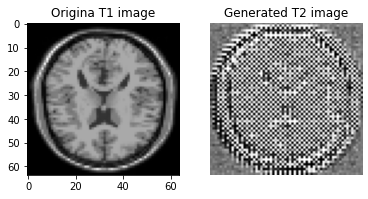

In [144]:
#Check output of Untrained Generator models for T2_generator

Tr1_images = os.listdir(Tr1_orig_path + 'TrainT1')
Tr1_img = cv2.imread(Tr1_orig_path + 'TrainT1/' + Tr1_images[6])
Tr1_img = cv2.cvtColor(Tr1_img,cv2.COLOR_BGR2RGB)
Tr1_img = cv2.resize(Tr1_img,(64,64))
img = np.zeros((1,64,64,3))
img[0,:,:,:] = Tr1_img

to_t2 = generator_t2(img)

plt.subplot(1,2,1)
plt.imshow(Tr1_img[:,:,0], cmap='gray')
plt.title('Origina T1 image')
plt.subplot(1,2,2)
plt.imshow(to_t2[0][:,:,0], cmap='gray')
plt.title('Generated T2 image')
plt.axis('off')
plt.plot()

(-0.5, 63.5, 63.5, -0.5)

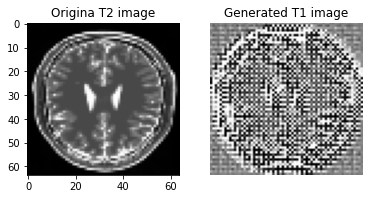

In [145]:
#Check output of Untrained Generator models for T1_generator

Tr2_images = os.listdir(Tr2_orig_path + 'TrainT2')
Tr2_img = cv2.imread(Tr2_orig_path + 'TrainT2/' + Tr2_images[6])
Tr2_img = cv2.cvtColor(Tr2_img,cv2.COLOR_BGR2RGB)
Tr2_img = cv2.resize(Tr2_img,(64,64))
img = np.zeros((1,64,64,3))
img[0,:,:,:] = Tr2_img

to_t1 = generator_t1(img)

plt.subplot(1,2,1)
plt.imshow(Tr2_img[:,:,0], cmap='gray')
plt.title('Origina T2 image')
plt.subplot(1,2,2)
plt.imshow(to_t1[0][:,:,0], cmap='gray')
plt.title('Generated T1 image')
plt.axis('off')

#### Calculating Losses

In [146]:
#creating loss object

loss_obj = keras.losses.BinaryCrossentropy(from_logits=True)

In [147]:
#Dicriminator loss (loss_generated + loss_real)

def discriminator_loss(real, generated):
    real_loss = loss_obj(tf.ones_like(real), real)
    gen_loss = loss_obj(tf.zeros_like(generated), generated)
    total_loss = real_loss + gen_loss
    return total_loss*0.5

In [148]:
#Generator loss

def generator_loss(generated):
    gen_loss = loss_obj(tf.ones_like(generated),generated)
    return gen_loss

In [149]:
#Cycle loss

def cycle_loss(real, cycled):
    cyc_loss = tf.reduce_mean(tf.abs(real - cycled))
    return cyc_loss

In [150]:
#Identity loss

def identity_loss(real,same):
    id_loss = tf.reduce_mean(tf.abs(real - same))
    return id_loss

#### Optimizer

In [151]:
#Epochs
EPOCHS = 200

In [152]:
lr=2e-4
decay_rate = lr/(EPOCHS+0.000001)

generator_t1_optimizer = keras.optimizers.Adam(learning_rate=lr, beta_1=0.5, decay=decay_rate)
generator_t2_optimizer = keras.optimizers.Adam(learning_rate=lr, beta_1=0.5, decay=decay_rate)

discriminator_t1_optimizer = keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5)
discriminator_t2_optimizer = keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5)

#### Checkpoint Initialization

In [153]:
checkpoint_path = "/Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model"

ckpt = tf.train.Checkpoint(generator_t1 = generator_t1,
                           generator_t2 = generator_t2,
                           discriminator_t1 = discriminator_t1,
                           discriminator_t2 = discriminator_t2,
                           generator_t1_optimizer = generator_t1_optimizer,
                           generator_t2_optimizer = generator_t2_optimizer,
                           discriminator_t1_optimizer = discriminator_t1_optimizer,
                           discriminator_t2_optimizer = discriminator_t2_optimizer
                          )

ckpt_manager = tf.train.CheckpointManager(ckpt, checkpoint_path, max_to_keep=3)

if ckpt_manager.latest_checkpoint:
    ckpt.restore(ckpt_manager.latest_checkpoint)
    print("Latest Checkpoint Restored")

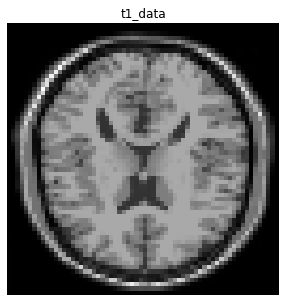

In [154]:
sample_t1_data = next(iter(Tr1_dataset))
plt.figure(figsize=(5, 5))
plt.imshow(sample_t1_data[6][:,:,0], cmap='gray')
plt.title('t1_data')
plt.axis('off')
plt.show()

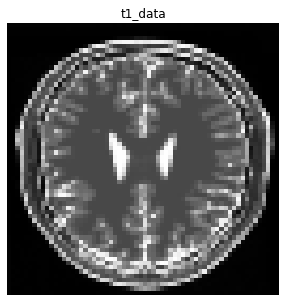

In [155]:
sample_t2_data = next(iter(Tr2_dataset))
plt.figure(figsize=(5, 5))
plt.imshow(sample_t2_data[6][:,:,0], cmap='gray')
plt.title('t1_data')
plt.axis('off')
plt.show()

In [156]:
def generate_images(model1, test_input1, model2, test_input2):
    prediction1 = model1(test_input1)
    prediction2 = model2(test_input2)
    plt.figure(figsize=(8, 4))
    display_list = [test_input1[6], prediction1[6], test_input2[6], prediction2[6]]
    title = ['Input Image', 'Predicted Image', 'Input Image', 'Predicted Image']
    for i in range(4):
        plt.subplot(1, 4, i+1)
        plt.title(title[i])
        plt.imshow(display_list[i][:, :, 0]*127.5 + 127.5, cmap='gray')
        plt.axis('off')

    plt.savefig('/Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/image_at_epoch_{:04d}.png'.format(epoch))
    plt.show()

#### Training

In [157]:
from tensorflow.keras import callbacks

In [158]:
@tf.function
def train_step(real_t1, real_t2):
    with tf.GradientTape(persistent=True) as tape:
        #step 1: generator t1 translates: t2 -> t1
        fake_t1 = generator_t1(real_t2, training=True)
        cycled_t2 = generator_t2(fake_t1, training=True)
        
        #step 2: generator t2 translates: t1 -> t2
        fake_t2 = generator_t2(real_t1, training=True)
        cycled_t1 = generator_t1(fake_t2, training=True)
        
        #step 3: Generate Same t1
        same_t1 = generator_t1(real_t1, training=True)
        
        #step 4: Generate same t2
        same_t2 = generator_t2(real_t2, training=True)
        
        #step 5: discriminator for real t1
        disc_real_t1 = discriminator_t1(real_t1, training=True) 
        
        #step 6: discriminator for real t2
        disc_real_t2 = discriminator_t2(real_t2, training=True)
        
        #step 7: discriminator for fake t1
        disc_fake_t1 = discriminator_t1(fake_t1, training=True) 
        
        #step 8: discriminator for fake t2
        disc_fake_t2 = discriminator_t2(fake_t2, training=True) 
        
        #step 9: calculate Generator loss
        gen_loss_t1  = generator_loss(disc_fake_t1)
        gen_loss_t2 = generator_loss(disc_fake_t2)
        
        #step 10: calculate total cycle loss
        total_cycle_loss = cycle_loss(real_t1,cycled_t1) + cycle_loss(real_t2, cycled_t2)
        
        #step 11: calculate total generator loss
        total_gen_loss_t1 = gen_loss_t1 + total_cycle_loss + identity_loss(real_t1, same_t1)
        total_gen_loss_t2 = gen_loss_t2 + total_cycle_loss + identity_loss(real_t2, same_t2)
        
        #step 12: calculate discriminator loss
        disc_loss_t1 = discriminator_loss(disc_real_t1, disc_fake_t1)
        disc_loss_t2 = discriminator_loss(disc_real_t2, disc_fake_t2)
        
    #calculate generator gradients
    generator_t1_grads = tape.gradient(total_gen_loss_t1, generator_t1.trainable_variables)
    generator_t2_grads = tape.gradient(total_gen_loss_t2, generator_t2.trainable_variables)
    
    #calculate discriminator gradients
    discriminator_t1_grads = tape.gradient(disc_loss_t1, discriminator_t1.trainable_variables)
    discriminator_t2_grads = tape.gradient(disc_loss_t2, discriminator_t2.trainable_variables)
    
    #apply gradients to generator optimizer
    generator_t1_optimizer.apply_gradients(zip(generator_t1_grads, generator_t1.trainable_variables))
    generator_t2_optimizer.apply_gradients(zip(generator_t2_grads, generator_t2.trainable_variables))
    
    #apply gradients to discriminator optimizer
    discriminator_t1_optimizer.apply_gradients(zip(discriminator_t1_grads, discriminator_t1.trainable_variables))
    discriminator_t2_optimizer.apply_gradients(zip(discriminator_t2_grads, discriminator_t2.trainable_variables))
    
    return total_gen_loss_t1, total_gen_loss_t2

#### Training model over Epochs

Training Epoch:  1


2021-11-02 15:36:56.227511: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:112] Plugin optimizer for device_type GPU is enabled.
2021-11-02 15:37:02.884962: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:112] Plugin optimizer for device_type GPU is enabled.


gen_t1_loss: 4.0989928642908735, gen_t2_loss: 4.0989928642908735


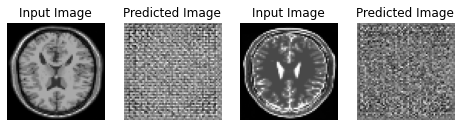

Saving checkpoint for epoch 1 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-1
Training Epoch:  2
gen_t1_loss: 3.818780521551768, gen_t2_loss: 3.818780521551768


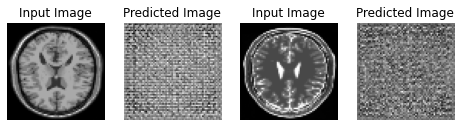

Saving checkpoint for epoch 2 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-2
Training Epoch:  3
gen_t1_loss: 16.566504736741383, gen_t2_loss: 16.566504736741383


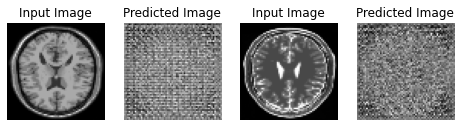

Saving checkpoint for epoch 3 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-3
Training Epoch:  4
gen_t1_loss: 4.944018920262654, gen_t2_loss: 4.944018920262654


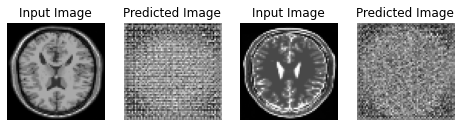

Saving checkpoint for epoch 4 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-4
Training Epoch:  5
gen_t1_loss: 8.355102062225342, gen_t2_loss: 8.355102062225342


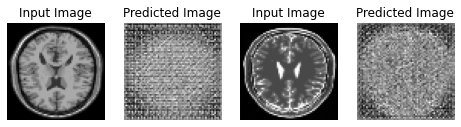

Saving checkpoint for epoch 5 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-5
Training Epoch:  6
gen_t1_loss: 8.640452722708384, gen_t2_loss: 8.640452722708384


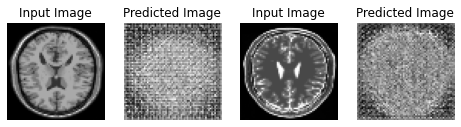

Saving checkpoint for epoch 6 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-6
Training Epoch:  7
gen_t1_loss: 13.477409740289053, gen_t2_loss: 13.477409740289053


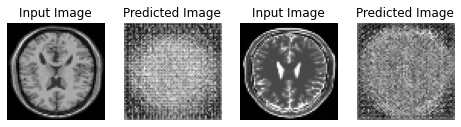

Saving checkpoint for epoch 7 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-7
Training Epoch:  8
gen_t1_loss: 19.385758300622303, gen_t2_loss: 19.385758300622303


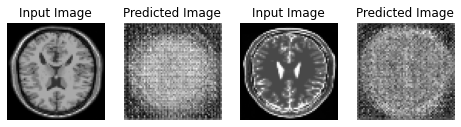

Saving checkpoint for epoch 8 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-8
Training Epoch:  9
gen_t1_loss: 8.39668494462967, gen_t2_loss: 8.39668494462967


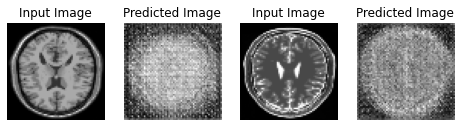

Saving checkpoint for epoch 9 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-9
Training Epoch:  10
gen_t1_loss: 8.97940363486608, gen_t2_loss: 8.97940363486608


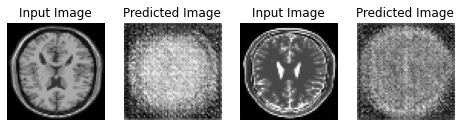

Saving checkpoint for epoch 10 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-10
Training Epoch:  11
gen_t1_loss: 9.524003813664118, gen_t2_loss: 9.524003813664118


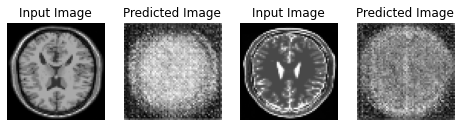

Saving checkpoint for epoch 11 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-11
Training Epoch:  12
gen_t1_loss: 12.061810205380121, gen_t2_loss: 12.061810205380121


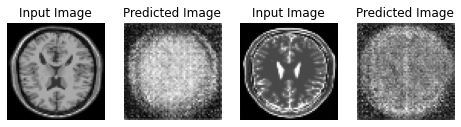

Saving checkpoint for epoch 12 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-12
Training Epoch:  13
gen_t1_loss: 14.048871805270513, gen_t2_loss: 14.048871805270513


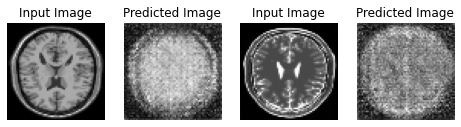

Saving checkpoint for epoch 13 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-13
Training Epoch:  14
gen_t1_loss: 7.85250852505366, gen_t2_loss: 7.85250852505366


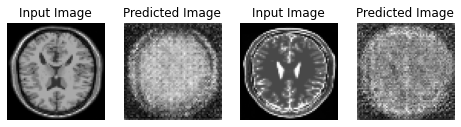

Saving checkpoint for epoch 14 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-14
Training Epoch:  15
gen_t1_loss: 9.0874476035436, gen_t2_loss: 9.0874476035436


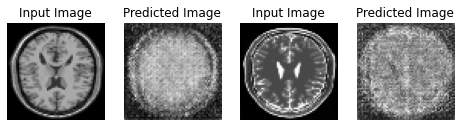

Saving checkpoint for epoch 15 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-15
Training Epoch:  16
gen_t1_loss: 15.444901665051779, gen_t2_loss: 15.444901665051779


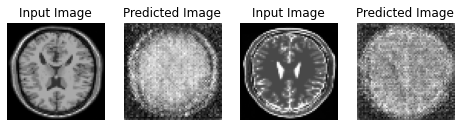

Saving checkpoint for epoch 16 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-16
Training Epoch:  17
gen_t1_loss: 11.3818588356177, gen_t2_loss: 11.3818588356177


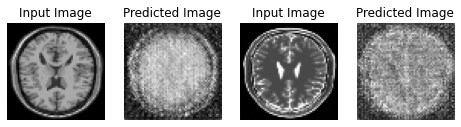

Saving checkpoint for epoch 17 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-17
Training Epoch:  18
gen_t1_loss: 16.953167935212452, gen_t2_loss: 16.953167935212452


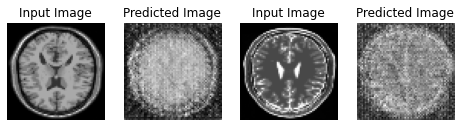

Saving checkpoint for epoch 18 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-18
Training Epoch:  19
gen_t1_loss: 10.935369749863943, gen_t2_loss: 10.935369749863943


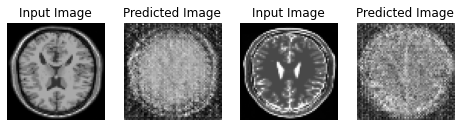

Saving checkpoint for epoch 19 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-19
Training Epoch:  20
gen_t1_loss: 8.195295373598734, gen_t2_loss: 8.195295373598734


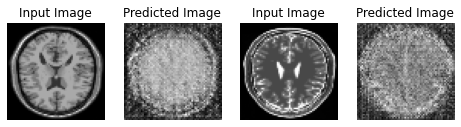

Saving checkpoint for epoch 20 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-20
Training Epoch:  21
gen_t1_loss: 10.207599222660065, gen_t2_loss: 10.207599222660065


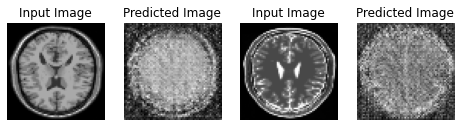

Saving checkpoint for epoch 21 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-21
Training Epoch:  22
gen_t1_loss: 8.340513209501902, gen_t2_loss: 8.340513209501902


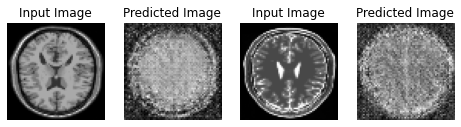

Saving checkpoint for epoch 22 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-22
Training Epoch:  23
gen_t1_loss: 17.853900233904522, gen_t2_loss: 17.853900233904522


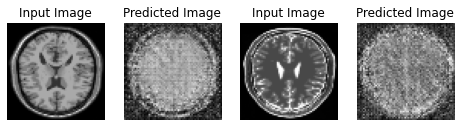

Saving checkpoint for epoch 23 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-23
Training Epoch:  24
gen_t1_loss: 14.253710150718689, gen_t2_loss: 14.253710150718689


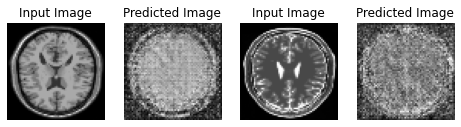

Saving checkpoint for epoch 24 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-24
Training Epoch:  25
gen_t1_loss: 11.736826042334238, gen_t2_loss: 11.736826042334238


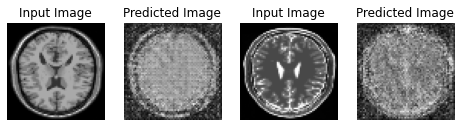

Saving checkpoint for epoch 25 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-25
Training Epoch:  26
gen_t1_loss: 9.31804351011912, gen_t2_loss: 9.31804351011912


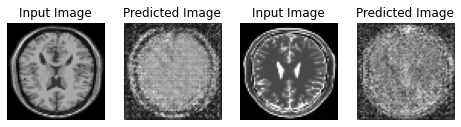

Saving checkpoint for epoch 26 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-26
Training Epoch:  27
gen_t1_loss: 7.40971905986468, gen_t2_loss: 7.40971905986468


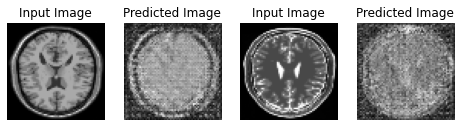

Saving checkpoint for epoch 27 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-27
Training Epoch:  28
gen_t1_loss: 17.47585626443227, gen_t2_loss: 17.47585626443227


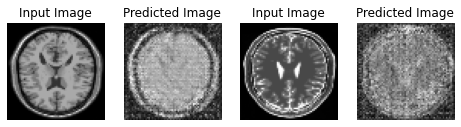

Saving checkpoint for epoch 28 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-28
Training Epoch:  29
gen_t1_loss: 14.591897010803223, gen_t2_loss: 14.591897010803223


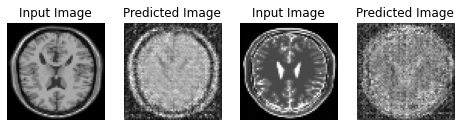

Saving checkpoint for epoch 29 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-29
Training Epoch:  30
gen_t1_loss: 17.045705179373424, gen_t2_loss: 17.045705179373424


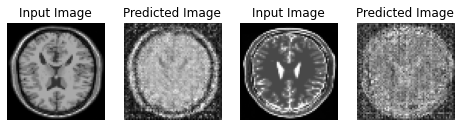

Saving checkpoint for epoch 30 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-30
Training Epoch:  31
gen_t1_loss: 25.71658589442571, gen_t2_loss: 25.71658589442571


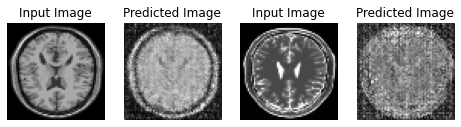

Saving checkpoint for epoch 31 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-31
Training Epoch:  32
gen_t1_loss: 15.29621402422587, gen_t2_loss: 15.29621402422587


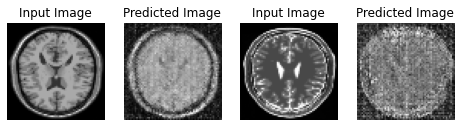

Saving checkpoint for epoch 32 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-32
Training Epoch:  33
gen_t1_loss: 17.380822161833446, gen_t2_loss: 17.380822161833446


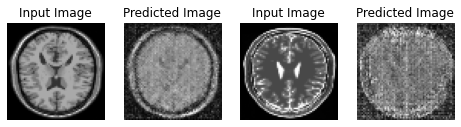

Saving checkpoint for epoch 33 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-33
Training Epoch:  34
gen_t1_loss: 10.432604223489761, gen_t2_loss: 10.432604223489761


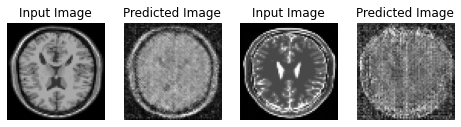

Saving checkpoint for epoch 34 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-34
Training Epoch:  35
gen_t1_loss: 12.59478243192037, gen_t2_loss: 12.59478243192037


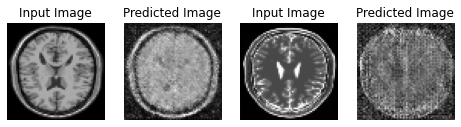

Saving checkpoint for epoch 35 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-35
Training Epoch:  36
gen_t1_loss: 18.252084612846375, gen_t2_loss: 18.252084612846375


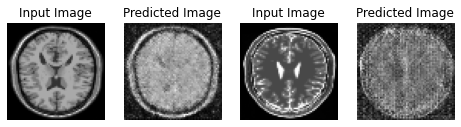

Saving checkpoint for epoch 36 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-36
Training Epoch:  37
gen_t1_loss: 16.22741723060608, gen_t2_loss: 16.22741723060608


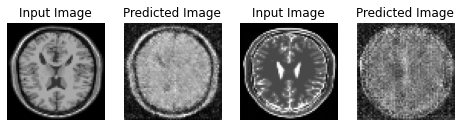

Saving checkpoint for epoch 37 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-37
Training Epoch:  38
gen_t1_loss: 23.26153103510539, gen_t2_loss: 23.26153103510539


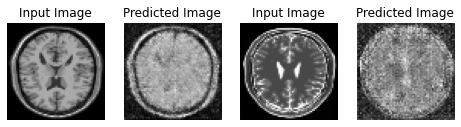

Saving checkpoint for epoch 38 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-38
Training Epoch:  39
gen_t1_loss: 7.879241665204366, gen_t2_loss: 7.879241665204366


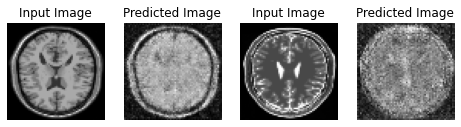

Saving checkpoint for epoch 39 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-39
Training Epoch:  40
gen_t1_loss: 11.60063236951828, gen_t2_loss: 11.60063236951828


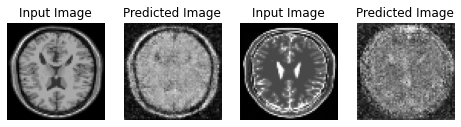

Saving checkpoint for epoch 40 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-40
Training Epoch:  41
gen_t1_loss: 20.548951387405396, gen_t2_loss: 20.548951387405396


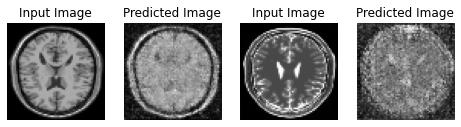

Saving checkpoint for epoch 41 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-41
Training Epoch:  42
gen_t1_loss: 14.516180843114853, gen_t2_loss: 14.516180843114853


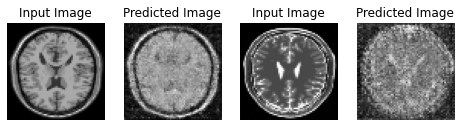

Saving checkpoint for epoch 42 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-42
Training Epoch:  43
gen_t1_loss: 13.878574113051096, gen_t2_loss: 13.878574113051096


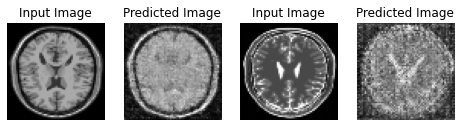

Saving checkpoint for epoch 43 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-43
Training Epoch:  44
gen_t1_loss: 24.225640177726746, gen_t2_loss: 24.225640177726746


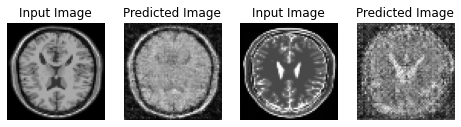

Saving checkpoint for epoch 44 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-44
Training Epoch:  45
gen_t1_loss: 10.169136613607407, gen_t2_loss: 10.169136613607407


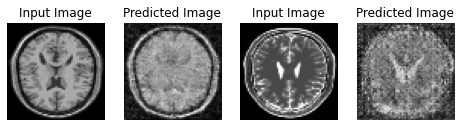

Saving checkpoint for epoch 45 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-45
Training Epoch:  46
gen_t1_loss: 20.59257483482361, gen_t2_loss: 20.59257483482361


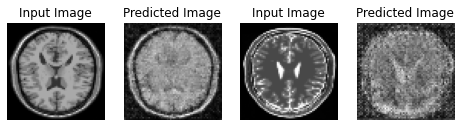

Saving checkpoint for epoch 46 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-46
Training Epoch:  47
gen_t1_loss: 9.349203636248907, gen_t2_loss: 9.349203636248907


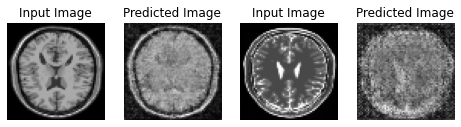

Saving checkpoint for epoch 47 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-47
Training Epoch:  48
gen_t1_loss: 28.152271231015522, gen_t2_loss: 28.152271231015522


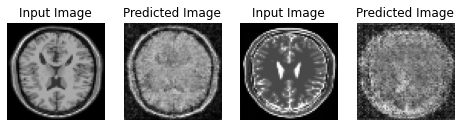

Saving checkpoint for epoch 48 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-48
Training Epoch:  49
gen_t1_loss: 11.291227579116821, gen_t2_loss: 11.291227579116821


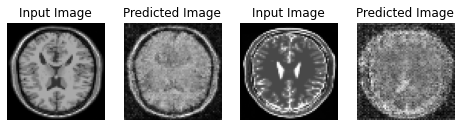

Saving checkpoint for epoch 49 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-49
Training Epoch:  50
gen_t1_loss: 19.871273577213287, gen_t2_loss: 19.871273577213287


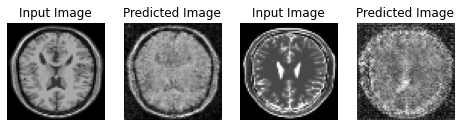

Saving checkpoint for epoch 50 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-50
Training Epoch:  51
gen_t1_loss: 12.491992930571238, gen_t2_loss: 12.491992930571238


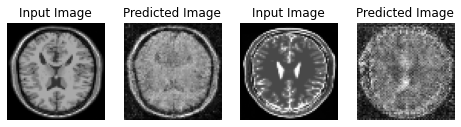

Saving checkpoint for epoch 51 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-51
Training Epoch:  52
gen_t1_loss: 14.638920098543167, gen_t2_loss: 14.638920098543167


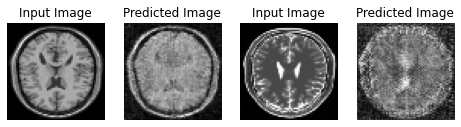

Saving checkpoint for epoch 52 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-52
Training Epoch:  53
gen_t1_loss: 24.702745874722797, gen_t2_loss: 24.702745874722797


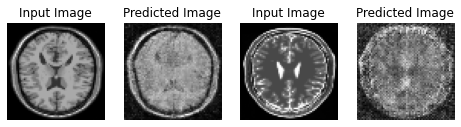

Saving checkpoint for epoch 53 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-53
Training Epoch:  54
gen_t1_loss: 18.29443297783534, gen_t2_loss: 18.29443297783534


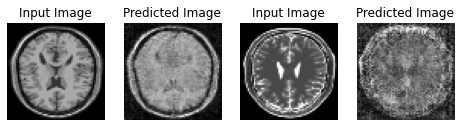

Saving checkpoint for epoch 54 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-54
Training Epoch:  55
gen_t1_loss: 27.453051616748173, gen_t2_loss: 27.453051616748173


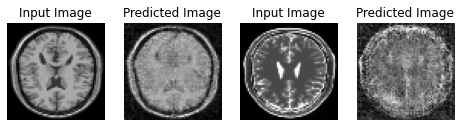

Saving checkpoint for epoch 55 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-55
Training Epoch:  56
gen_t1_loss: 16.160850435495377, gen_t2_loss: 16.160850435495377


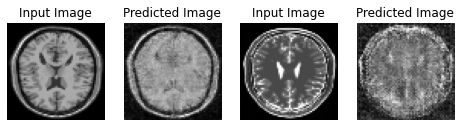

Saving checkpoint for epoch 56 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-56
Training Epoch:  57
gen_t1_loss: 24.586681107680004, gen_t2_loss: 24.586681107680004


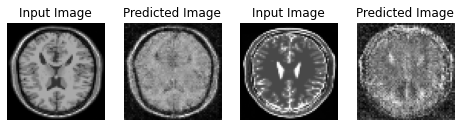

Saving checkpoint for epoch 57 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-57
Training Epoch:  58
gen_t1_loss: 13.239018400510153, gen_t2_loss: 13.239018400510153


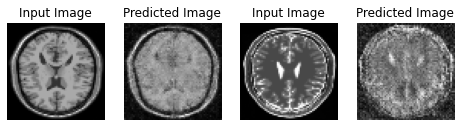

Saving checkpoint for epoch 58 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-58
Training Epoch:  59
gen_t1_loss: 30.48548622926076, gen_t2_loss: 30.48548622926076


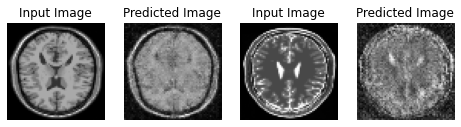

Saving checkpoint for epoch 59 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-59
Training Epoch:  60
gen_t1_loss: 16.743428150812786, gen_t2_loss: 16.743428150812786


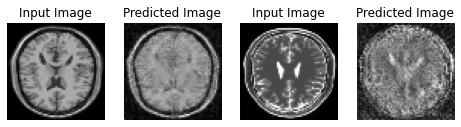

Saving checkpoint for epoch 60 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-60
Training Epoch:  61
gen_t1_loss: 14.413782636324564, gen_t2_loss: 14.413782636324564


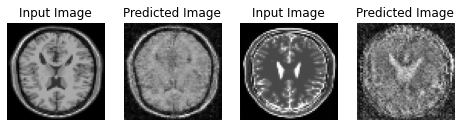

Saving checkpoint for epoch 61 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-61
Training Epoch:  62
gen_t1_loss: 9.669314901034037, gen_t2_loss: 9.669314901034037


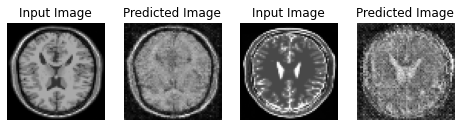

Saving checkpoint for epoch 62 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-62
Training Epoch:  63
gen_t1_loss: 17.724803407986958, gen_t2_loss: 17.724803407986958


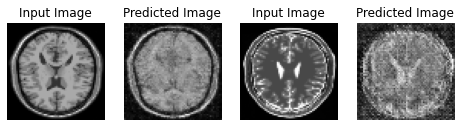

Saving checkpoint for epoch 63 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-63
Training Epoch:  64
gen_t1_loss: 17.28751775622368, gen_t2_loss: 17.28751775622368


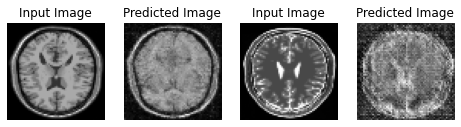

Saving checkpoint for epoch 64 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-64
Training Epoch:  65
gen_t1_loss: 15.129423459370932, gen_t2_loss: 15.129423459370932


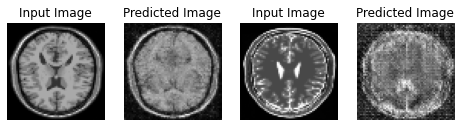

Saving checkpoint for epoch 65 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-65
Training Epoch:  66
gen_t1_loss: 32.33015767733256, gen_t2_loss: 32.33015767733256


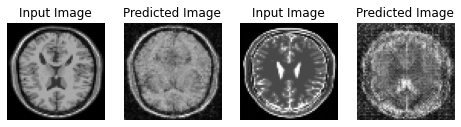

Saving checkpoint for epoch 66 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-66
Training Epoch:  67
gen_t1_loss: 19.623892774184544, gen_t2_loss: 19.623892774184544


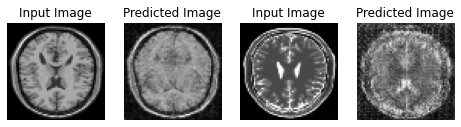

Saving checkpoint for epoch 67 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-67
Training Epoch:  68
gen_t1_loss: 14.600423018137613, gen_t2_loss: 14.600423018137613


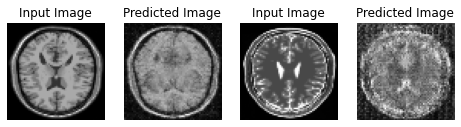

Saving checkpoint for epoch 68 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-68
Training Epoch:  69
gen_t1_loss: 29.720011711120605, gen_t2_loss: 29.720011711120605


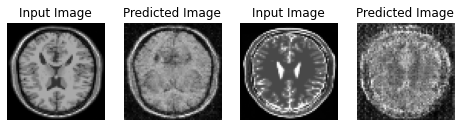

Saving checkpoint for epoch 69 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-69
Training Epoch:  70
gen_t1_loss: 13.655018329620361, gen_t2_loss: 13.655018329620361


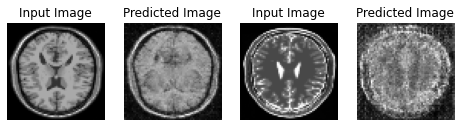

Saving checkpoint for epoch 70 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-70
Training Epoch:  71
gen_t1_loss: 22.757563283046085, gen_t2_loss: 22.757563283046085


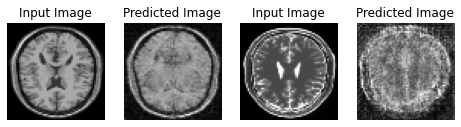

Saving checkpoint for epoch 71 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-71
Training Epoch:  72
gen_t1_loss: 16.412113825480144, gen_t2_loss: 16.412113825480144


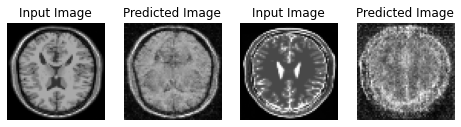

Saving checkpoint for epoch 72 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-72
Training Epoch:  73
gen_t1_loss: 13.625509689251581, gen_t2_loss: 13.625509689251581


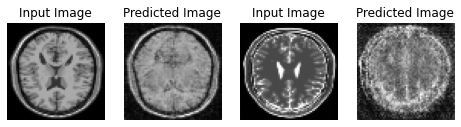

Saving checkpoint for epoch 73 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-73
Training Epoch:  74
gen_t1_loss: 14.620625495910645, gen_t2_loss: 14.620625495910645


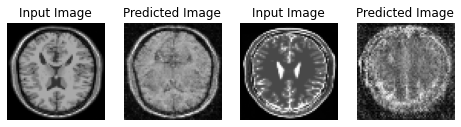

Saving checkpoint for epoch 74 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-74
Training Epoch:  75
gen_t1_loss: 8.083546360333761, gen_t2_loss: 8.083546360333761


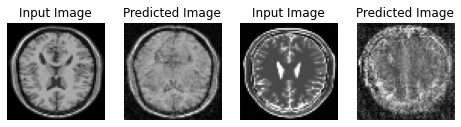

Saving checkpoint for epoch 75 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-75
Training Epoch:  76
gen_t1_loss: 19.266936401526134, gen_t2_loss: 19.266936401526134


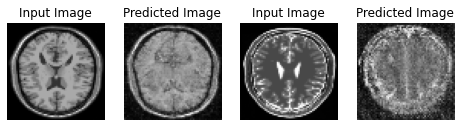

Saving checkpoint for epoch 76 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-76
Training Epoch:  77
gen_t1_loss: 14.42742125193278, gen_t2_loss: 14.42742125193278


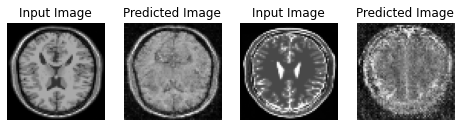

Saving checkpoint for epoch 77 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-77
Training Epoch:  78
gen_t1_loss: 7.989616135756175, gen_t2_loss: 7.989616135756175


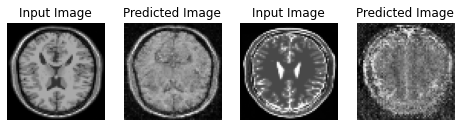

Saving checkpoint for epoch 78 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-78
Training Epoch:  79
gen_t1_loss: 21.868057658274967, gen_t2_loss: 21.868057658274967


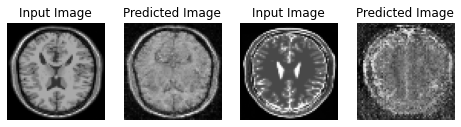

Saving checkpoint for epoch 79 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-79
Training Epoch:  80
gen_t1_loss: 29.974340051412582, gen_t2_loss: 29.974340051412582


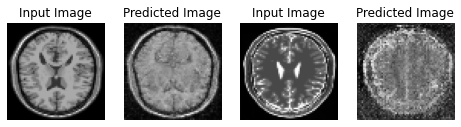

Saving checkpoint for epoch 80 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-80
Training Epoch:  81
gen_t1_loss: 20.862069129943848, gen_t2_loss: 20.862069129943848


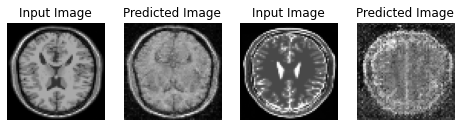

Saving checkpoint for epoch 81 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-81
Training Epoch:  82
gen_t1_loss: 10.660081545511881, gen_t2_loss: 10.660081545511881


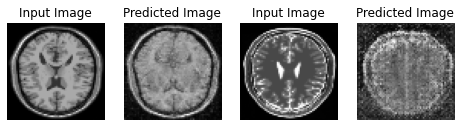

Saving checkpoint for epoch 82 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-82
Training Epoch:  83
gen_t1_loss: 11.248708168665567, gen_t2_loss: 11.248708168665567


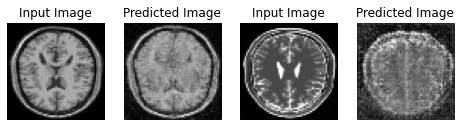

Saving checkpoint for epoch 83 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-83
Training Epoch:  84
gen_t1_loss: 14.68200127283732, gen_t2_loss: 14.68200127283732


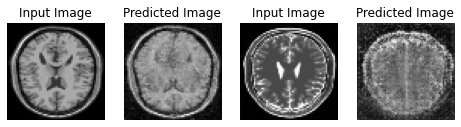

Saving checkpoint for epoch 84 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-84
Training Epoch:  85
gen_t1_loss: 8.326312144597372, gen_t2_loss: 8.326312144597372


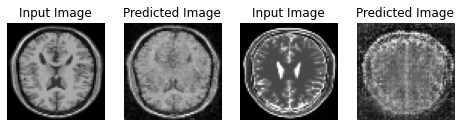

Saving checkpoint for epoch 85 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-85
Training Epoch:  86
gen_t1_loss: 7.454374194145203, gen_t2_loss: 7.454374194145203


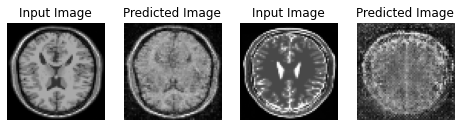

Saving checkpoint for epoch 86 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-86
Training Epoch:  87
gen_t1_loss: 18.25067202250163, gen_t2_loss: 18.25067202250163


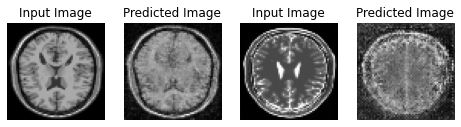

Saving checkpoint for epoch 87 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-87
Training Epoch:  88
gen_t1_loss: 9.266199111938477, gen_t2_loss: 9.266199111938477


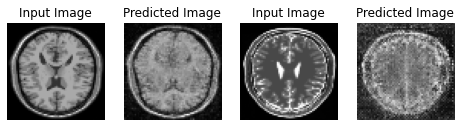

Saving checkpoint for epoch 88 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-88
Training Epoch:  89
gen_t1_loss: 7.0445535977681475, gen_t2_loss: 7.0445535977681475


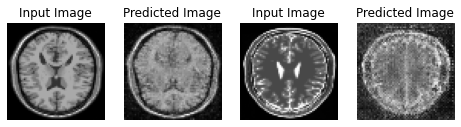

Saving checkpoint for epoch 89 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-89
Training Epoch:  90
gen_t1_loss: 5.674340258042018, gen_t2_loss: 5.674340258042018


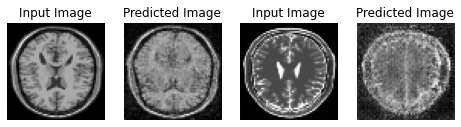

Saving checkpoint for epoch 90 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-90
Training Epoch:  91
gen_t1_loss: 23.596525351206463, gen_t2_loss: 23.596525351206463


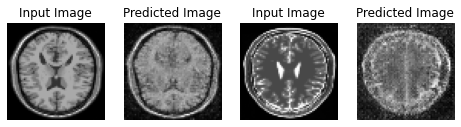

Saving checkpoint for epoch 91 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-91
Training Epoch:  92
gen_t1_loss: 7.836624622344971, gen_t2_loss: 7.836624622344971


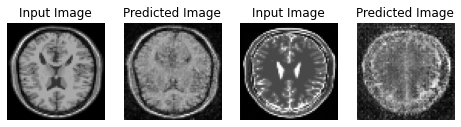

Saving checkpoint for epoch 92 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-92
Training Epoch:  93
gen_t1_loss: 6.3109776477018995, gen_t2_loss: 6.3109776477018995


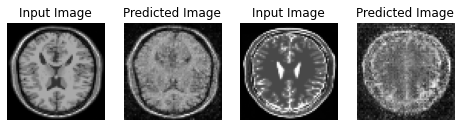

Saving checkpoint for epoch 93 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-93
Training Epoch:  94
gen_t1_loss: 30.053020358085632, gen_t2_loss: 30.053020358085632


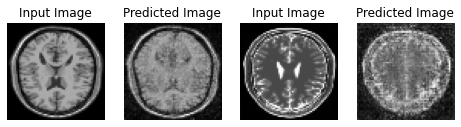

Saving checkpoint for epoch 94 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-94
Training Epoch:  95
gen_t1_loss: 27.860713322957356, gen_t2_loss: 27.860713322957356


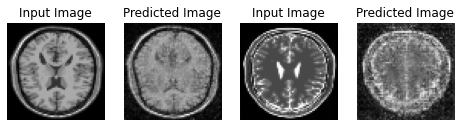

Saving checkpoint for epoch 95 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-95
Training Epoch:  96
gen_t1_loss: 17.369868119557697, gen_t2_loss: 17.369868119557697


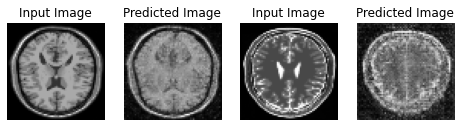

Saving checkpoint for epoch 96 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-96
Training Epoch:  97
gen_t1_loss: 9.633932511011759, gen_t2_loss: 9.633932511011759


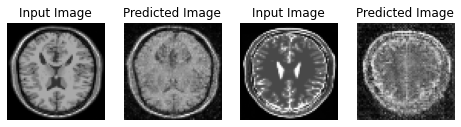

Saving checkpoint for epoch 97 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-97
Training Epoch:  98
gen_t1_loss: 8.257939348618189, gen_t2_loss: 8.257939348618189


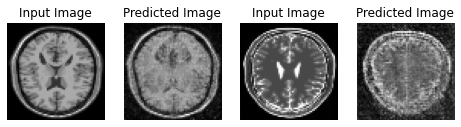

Saving checkpoint for epoch 98 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-98
Training Epoch:  99
gen_t1_loss: 17.708796461423237, gen_t2_loss: 17.708796461423237


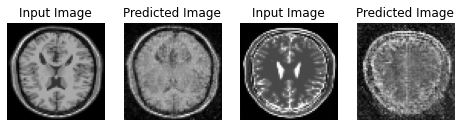

Saving checkpoint for epoch 99 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-99
Training Epoch:  100
gen_t1_loss: 8.156519889831543, gen_t2_loss: 8.156519889831543


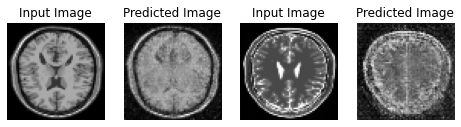

Saving checkpoint for epoch 100 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-100
Training Epoch:  101
gen_t1_loss: 31.797095596790314, gen_t2_loss: 31.797095596790314


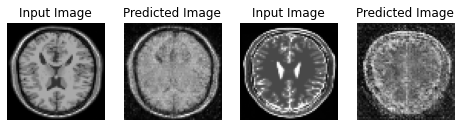

Saving checkpoint for epoch 101 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-101
Training Epoch:  102
gen_t1_loss: 35.41935095191002, gen_t2_loss: 35.41935095191002


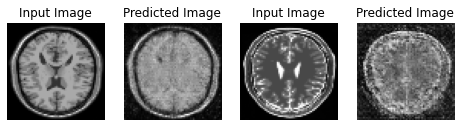

Saving checkpoint for epoch 102 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-102
Training Epoch:  103
gen_t1_loss: 22.813599328200024, gen_t2_loss: 22.813599328200024


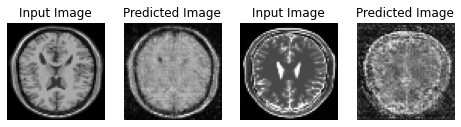

Saving checkpoint for epoch 103 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-103
Training Epoch:  104
gen_t1_loss: 34.64640736579895, gen_t2_loss: 34.64640736579895


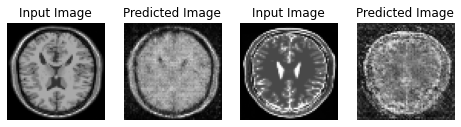

Saving checkpoint for epoch 104 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-104
Training Epoch:  105
gen_t1_loss: 26.783181707064312, gen_t2_loss: 26.783181707064312


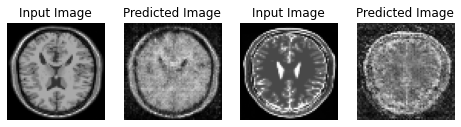

Saving checkpoint for epoch 105 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-105
Training Epoch:  106
gen_t1_loss: 10.646162470181784, gen_t2_loss: 10.646162470181784


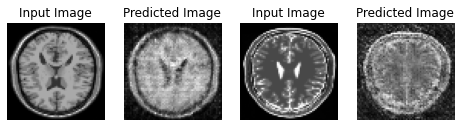

Saving checkpoint for epoch 106 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-106
Training Epoch:  107
gen_t1_loss: 26.118001600106556, gen_t2_loss: 26.118001600106556


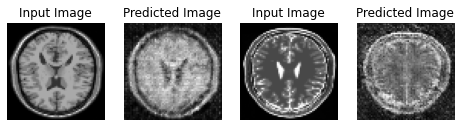

Saving checkpoint for epoch 107 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-107
Training Epoch:  108
gen_t1_loss: 11.653112967809042, gen_t2_loss: 11.653112967809042


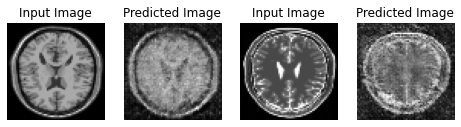

Saving checkpoint for epoch 108 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-108
Training Epoch:  109
gen_t1_loss: 18.235054085652035, gen_t2_loss: 18.235054085652035


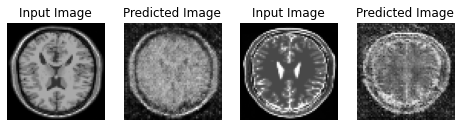

Saving checkpoint for epoch 109 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-109
Training Epoch:  110
gen_t1_loss: 21.33716074625651, gen_t2_loss: 21.33716074625651


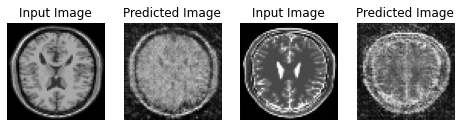

Saving checkpoint for epoch 110 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-110
Training Epoch:  111
gen_t1_loss: 10.184931695461273, gen_t2_loss: 10.184931695461273


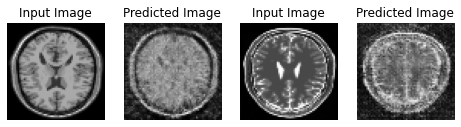

Saving checkpoint for epoch 111 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-111
Training Epoch:  112
gen_t1_loss: 20.643129487832386, gen_t2_loss: 20.643129487832386


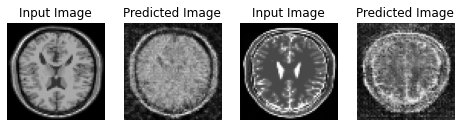

Saving checkpoint for epoch 112 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-112
Training Epoch:  113
gen_t1_loss: 9.540945609410604, gen_t2_loss: 9.540945609410604


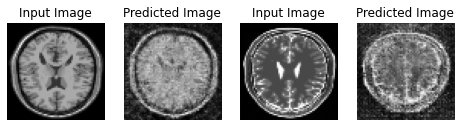

Saving checkpoint for epoch 113 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-113
Training Epoch:  114
gen_t1_loss: 22.987307210763294, gen_t2_loss: 22.987307210763294


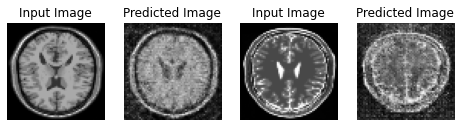

Saving checkpoint for epoch 114 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-114
Training Epoch:  115
gen_t1_loss: 10.532768527666727, gen_t2_loss: 10.532768527666727


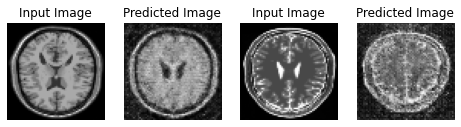

Saving checkpoint for epoch 115 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-115
Training Epoch:  116
gen_t1_loss: 21.721681634585064, gen_t2_loss: 21.721681634585064


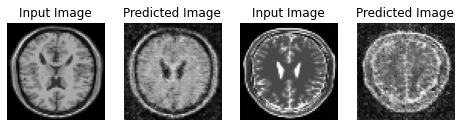

Saving checkpoint for epoch 116 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-116
Training Epoch:  117
gen_t1_loss: 14.850491424401602, gen_t2_loss: 14.850491424401602


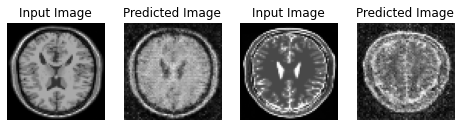

Saving checkpoint for epoch 117 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-117
Training Epoch:  118
gen_t1_loss: 28.99692306915919, gen_t2_loss: 28.99692306915919


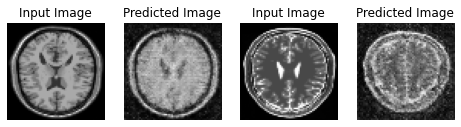

Saving checkpoint for epoch 118 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-118
Training Epoch:  119
gen_t1_loss: 31.311651438474655, gen_t2_loss: 31.311651438474655


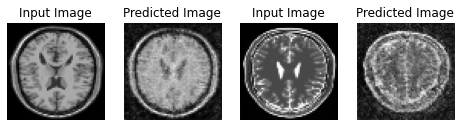

Saving checkpoint for epoch 119 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-119
Training Epoch:  120
gen_t1_loss: 18.783607343832653, gen_t2_loss: 18.783607343832653


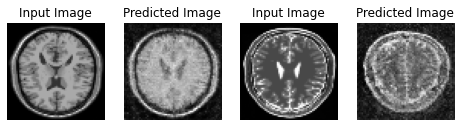

Saving checkpoint for epoch 120 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-120
Training Epoch:  121
gen_t1_loss: 41.50926332672437, gen_t2_loss: 41.50926332672437


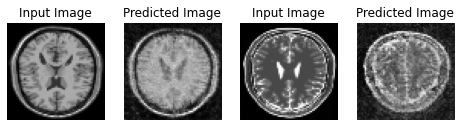

Saving checkpoint for epoch 121 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-121
Training Epoch:  122
gen_t1_loss: 53.5178704559803, gen_t2_loss: 53.5178704559803


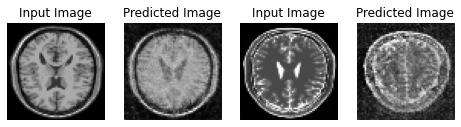

Saving checkpoint for epoch 122 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-122
Training Epoch:  123
gen_t1_loss: 31.988986174265545, gen_t2_loss: 31.988986174265545


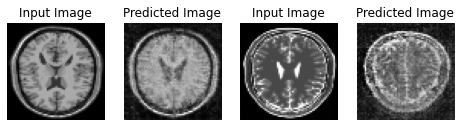

Saving checkpoint for epoch 123 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-123
Training Epoch:  124
gen_t1_loss: 39.419226874907814, gen_t2_loss: 39.419226874907814


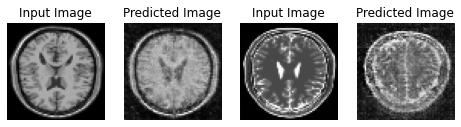

Saving checkpoint for epoch 124 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-124
Training Epoch:  125
gen_t1_loss: 24.359888354937237, gen_t2_loss: 24.359888354937237


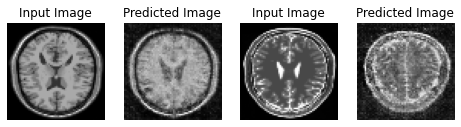

Saving checkpoint for epoch 125 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-125
Training Epoch:  126
gen_t1_loss: 30.420885423819225, gen_t2_loss: 30.420885423819225


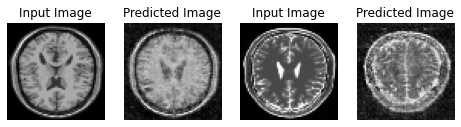

Saving checkpoint for epoch 126 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-126
Training Epoch:  127
gen_t1_loss: 33.00546975930532, gen_t2_loss: 33.00546975930532


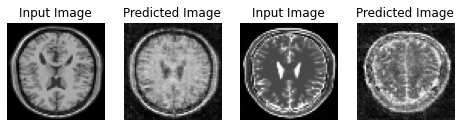

Saving checkpoint for epoch 127 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-127
Training Epoch:  128
gen_t1_loss: 23.130502065022785, gen_t2_loss: 23.130502065022785


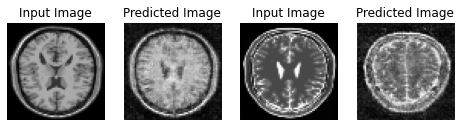

Saving checkpoint for epoch 128 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-128
Training Epoch:  129
gen_t1_loss: 16.98059852917989, gen_t2_loss: 16.98059852917989


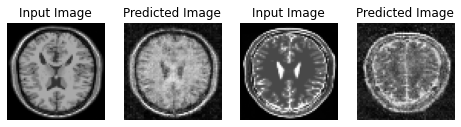

Saving checkpoint for epoch 129 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-129
Training Epoch:  130
gen_t1_loss: 43.038836826880775, gen_t2_loss: 43.038836826880775


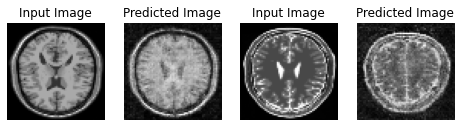

Saving checkpoint for epoch 130 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-130
Training Epoch:  131
gen_t1_loss: 23.076619903246563, gen_t2_loss: 23.076619903246563


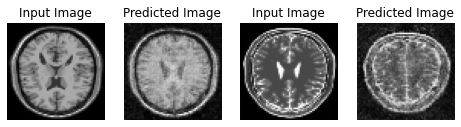

Saving checkpoint for epoch 131 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-131
Training Epoch:  132
gen_t1_loss: 41.32311199108759, gen_t2_loss: 41.32311199108759


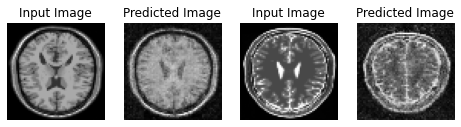

Saving checkpoint for epoch 132 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-132
Training Epoch:  133
gen_t1_loss: 37.10332045952479, gen_t2_loss: 37.10332045952479


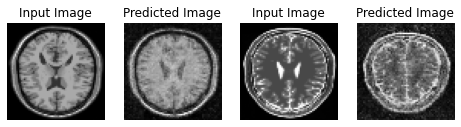

Saving checkpoint for epoch 133 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-133
Training Epoch:  134
gen_t1_loss: 23.58125701546669, gen_t2_loss: 23.58125701546669


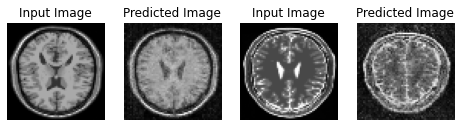

Saving checkpoint for epoch 134 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-134
Training Epoch:  135
gen_t1_loss: 27.130158762137096, gen_t2_loss: 27.130158762137096


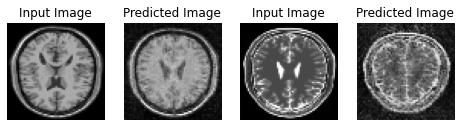

Saving checkpoint for epoch 135 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-135
Training Epoch:  136
gen_t1_loss: 42.005544106165566, gen_t2_loss: 42.005544106165566


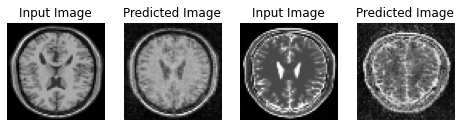

Saving checkpoint for epoch 136 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-136
Training Epoch:  137
gen_t1_loss: 24.682927310466766, gen_t2_loss: 24.682927310466766


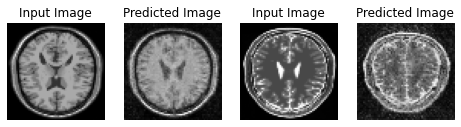

Saving checkpoint for epoch 137 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-137
Training Epoch:  138
gen_t1_loss: 39.6442576845487, gen_t2_loss: 39.6442576845487


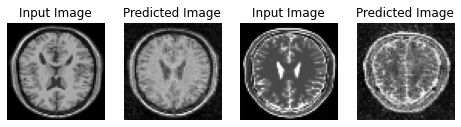

Saving checkpoint for epoch 138 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-138
Training Epoch:  139
gen_t1_loss: 36.819870779911675, gen_t2_loss: 36.819870779911675


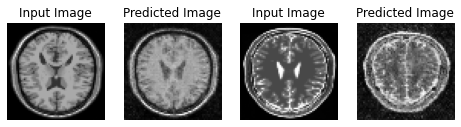

Saving checkpoint for epoch 139 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-139
Training Epoch:  140
gen_t1_loss: 25.911809345086414, gen_t2_loss: 25.911809345086414


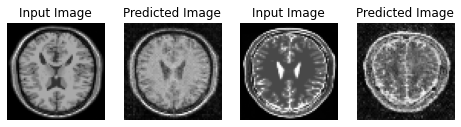

Saving checkpoint for epoch 140 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-140
Training Epoch:  141
gen_t1_loss: 43.458412985006966, gen_t2_loss: 43.458412985006966


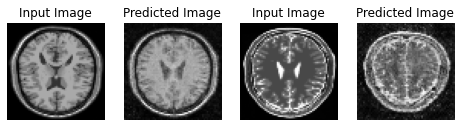

Saving checkpoint for epoch 141 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-141
Training Epoch:  142
gen_t1_loss: 25.901651004950207, gen_t2_loss: 25.901651004950207


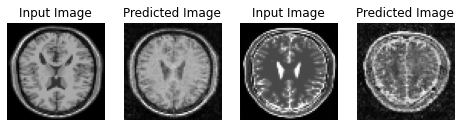

Saving checkpoint for epoch 142 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-142
Training Epoch:  143
gen_t1_loss: 42.11226997772852, gen_t2_loss: 42.11226997772852


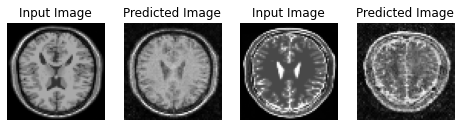

Saving checkpoint for epoch 143 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-143
Training Epoch:  144
gen_t1_loss: 27.056364486614864, gen_t2_loss: 27.056364486614864


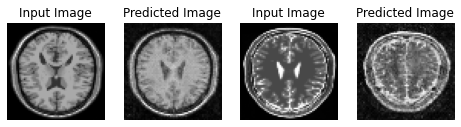

Saving checkpoint for epoch 144 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-144
Training Epoch:  145
gen_t1_loss: 42.78638035058975, gen_t2_loss: 42.78638035058975


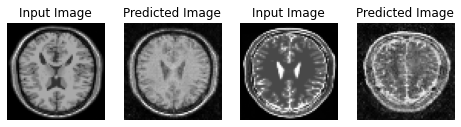

Saving checkpoint for epoch 145 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-145
Training Epoch:  146
gen_t1_loss: 41.04982871810595, gen_t2_loss: 41.04982871810595


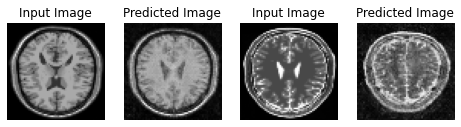

Saving checkpoint for epoch 146 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-146
Training Epoch:  147
gen_t1_loss: 37.48092074195544, gen_t2_loss: 37.48092074195544


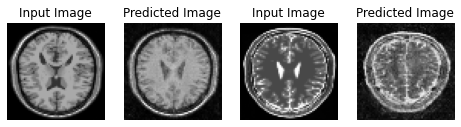

Saving checkpoint for epoch 147 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-147
Training Epoch:  148
gen_t1_loss: 32.837987105051674, gen_t2_loss: 32.837987105051674


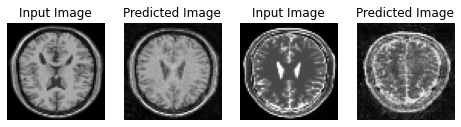

Saving checkpoint for epoch 148 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-148
Training Epoch:  149
gen_t1_loss: 40.582304219404854, gen_t2_loss: 40.582304219404854


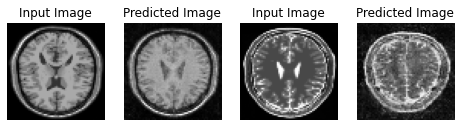

Saving checkpoint for epoch 149 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-149
Training Epoch:  150
gen_t1_loss: 34.99498403072357, gen_t2_loss: 34.99498403072357


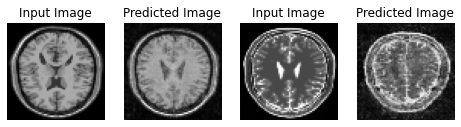

Saving checkpoint for epoch 150 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-150
Training Epoch:  151
gen_t1_loss: 42.46015908320745, gen_t2_loss: 42.46015908320745


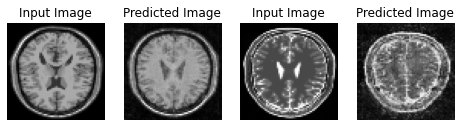

Saving checkpoint for epoch 151 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-151
Training Epoch:  152
gen_t1_loss: 15.751159191131592, gen_t2_loss: 15.751159191131592


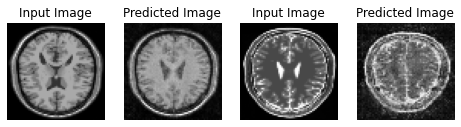

Saving checkpoint for epoch 152 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-152
Training Epoch:  153
gen_t1_loss: 10.258874098459879, gen_t2_loss: 10.258874098459879


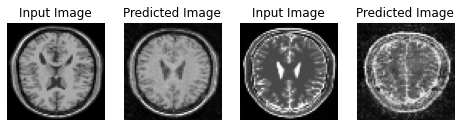

Saving checkpoint for epoch 153 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-153
Training Epoch:  154
gen_t1_loss: 7.676836252212524, gen_t2_loss: 7.676836252212524


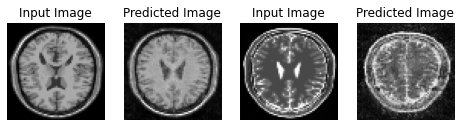

Saving checkpoint for epoch 154 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-154
Training Epoch:  155
gen_t1_loss: 7.793021519978841, gen_t2_loss: 7.793021519978841


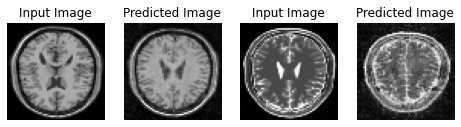

Saving checkpoint for epoch 155 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-155
Training Epoch:  156
gen_t1_loss: 12.837124188741049, gen_t2_loss: 12.837124188741049


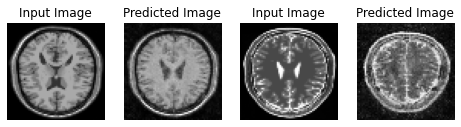

Saving checkpoint for epoch 156 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-156
Training Epoch:  157
gen_t1_loss: 44.63988224665324, gen_t2_loss: 44.63988224665324


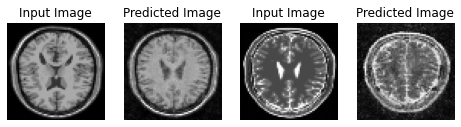

Saving checkpoint for epoch 157 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-157
Training Epoch:  158
gen_t1_loss: 35.176823288202286, gen_t2_loss: 35.176823288202286


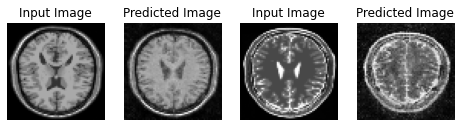

Saving checkpoint for epoch 158 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-158
Training Epoch:  159
gen_t1_loss: 37.818947315216064, gen_t2_loss: 37.818947315216064


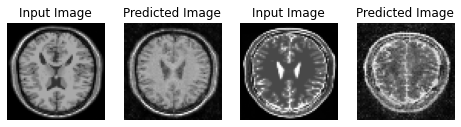

Saving checkpoint for epoch 159 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-159
Training Epoch:  160
gen_t1_loss: 38.62544545531273, gen_t2_loss: 38.62544545531273


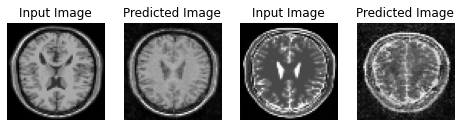

Saving checkpoint for epoch 160 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-160
Training Epoch:  161
gen_t1_loss: 38.156237890323006, gen_t2_loss: 38.156237890323006


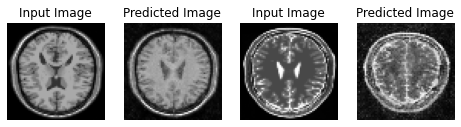

Saving checkpoint for epoch 161 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-161
Training Epoch:  162
gen_t1_loss: 37.88082883755366, gen_t2_loss: 37.88082883755366


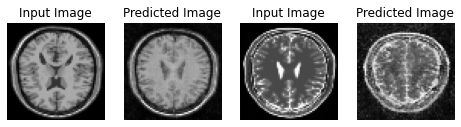

Saving checkpoint for epoch 162 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-162
Training Epoch:  163
gen_t1_loss: 38.01198509335518, gen_t2_loss: 38.01198509335518


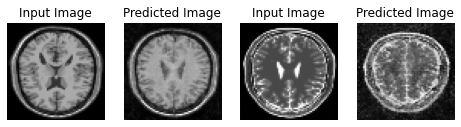

Saving checkpoint for epoch 163 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-163
Training Epoch:  164
gen_t1_loss: 39.77098120252291, gen_t2_loss: 39.77098120252291


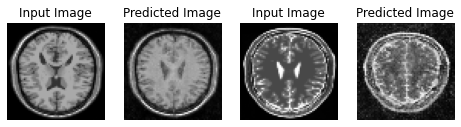

Saving checkpoint for epoch 164 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-164
Training Epoch:  165
gen_t1_loss: 10.336263378461203, gen_t2_loss: 10.336263378461203


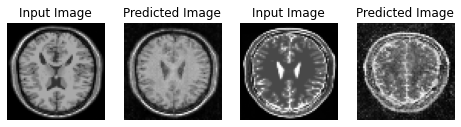

Saving checkpoint for epoch 165 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-165
Training Epoch:  166
gen_t1_loss: 9.757420539855957, gen_t2_loss: 9.757420539855957


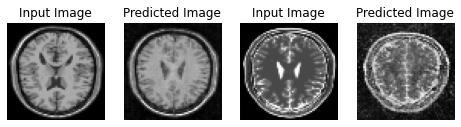

Saving checkpoint for epoch 166 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-166
Training Epoch:  167
gen_t1_loss: 10.007328589757284, gen_t2_loss: 10.007328589757284


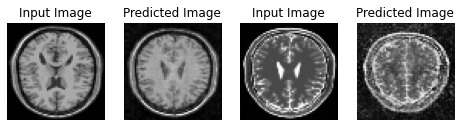

Saving checkpoint for epoch 167 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-167
Training Epoch:  168
gen_t1_loss: 8.97259553273519, gen_t2_loss: 8.97259553273519


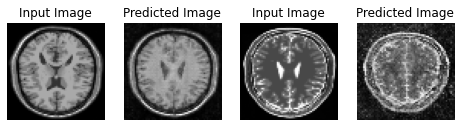

Saving checkpoint for epoch 168 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-168
Training Epoch:  169
gen_t1_loss: 7.5402317841847735, gen_t2_loss: 7.5402317841847735


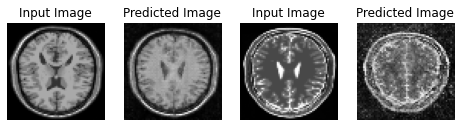

Saving checkpoint for epoch 169 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-169
Training Epoch:  170
gen_t1_loss: 7.503441492716472, gen_t2_loss: 7.503441492716472


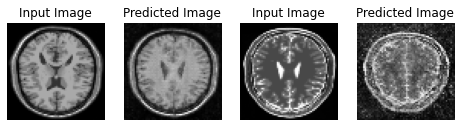

Saving checkpoint for epoch 170 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-170
Training Epoch:  171
gen_t1_loss: 7.150708834330241, gen_t2_loss: 7.150708834330241


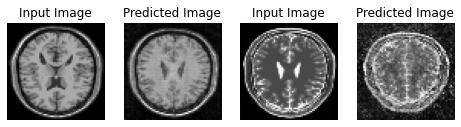

Saving checkpoint for epoch 171 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-171
Training Epoch:  172
gen_t1_loss: 6.954245726267497, gen_t2_loss: 6.954245726267497


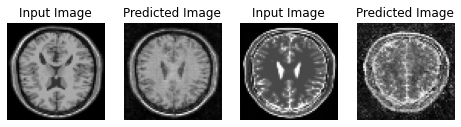

Saving checkpoint for epoch 172 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-172
Training Epoch:  173
gen_t1_loss: 10.281754096349081, gen_t2_loss: 10.281754096349081


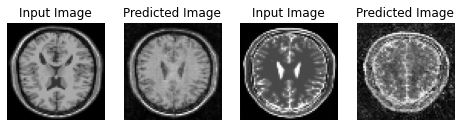

Saving checkpoint for epoch 173 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-173
Training Epoch:  174
gen_t1_loss: 9.837833484013876, gen_t2_loss: 9.837833484013876


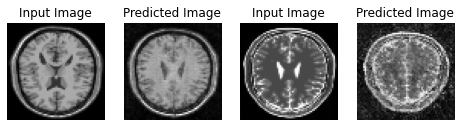

Saving checkpoint for epoch 174 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-174
Training Epoch:  175
gen_t1_loss: 12.572013258934021, gen_t2_loss: 12.572013258934021


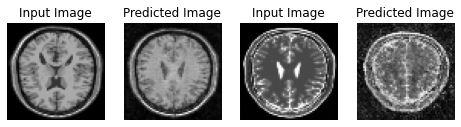

Saving checkpoint for epoch 175 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-175
Training Epoch:  176
gen_t1_loss: 11.408478260040283, gen_t2_loss: 11.408478260040283


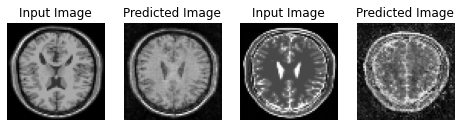

Saving checkpoint for epoch 176 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-176
Training Epoch:  177
gen_t1_loss: 7.09495210647583, gen_t2_loss: 7.09495210647583


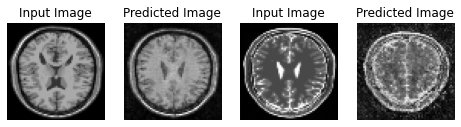

Saving checkpoint for epoch 177 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-177
Training Epoch:  178
gen_t1_loss: 11.754677017529806, gen_t2_loss: 11.754677017529806


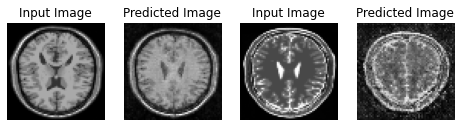

Saving checkpoint for epoch 178 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-178
Training Epoch:  179
gen_t1_loss: 32.31657208998998, gen_t2_loss: 32.31657208998998


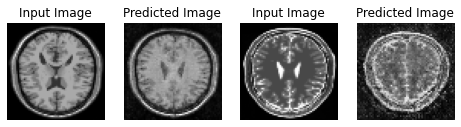

Saving checkpoint for epoch 179 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-179
Training Epoch:  180
gen_t1_loss: 7.786293705304463, gen_t2_loss: 7.786293705304463


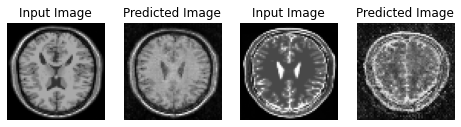

Saving checkpoint for epoch 180 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-180
Training Epoch:  181
gen_t1_loss: 7.894779284795125, gen_t2_loss: 7.894779284795125


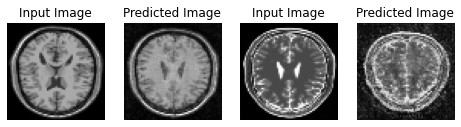

Saving checkpoint for epoch 181 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-181
Training Epoch:  182
gen_t1_loss: 7.690986712773641, gen_t2_loss: 7.690986712773641


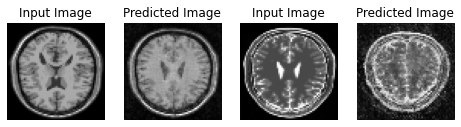

Saving checkpoint for epoch 182 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-182
Training Epoch:  183
gen_t1_loss: 7.173123041788737, gen_t2_loss: 7.173123041788737


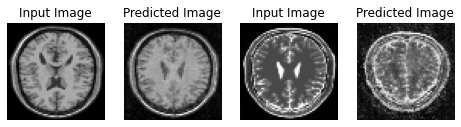

Saving checkpoint for epoch 183 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-183
Training Epoch:  184
gen_t1_loss: 6.823296705881755, gen_t2_loss: 6.823296705881755


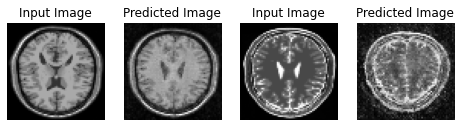

Saving checkpoint for epoch 184 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-184
Training Epoch:  185
gen_t1_loss: 7.248204072316487, gen_t2_loss: 7.248204072316487


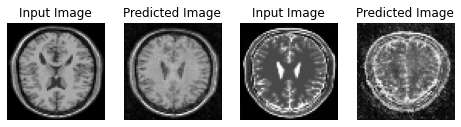

Saving checkpoint for epoch 185 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-185
Training Epoch:  186
gen_t1_loss: 7.380755662918091, gen_t2_loss: 7.380755662918091


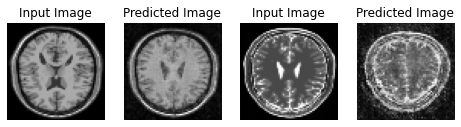

Saving checkpoint for epoch 186 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-186
Training Epoch:  187
gen_t1_loss: 8.226878007253012, gen_t2_loss: 8.226878007253012


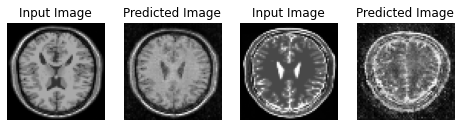

Saving checkpoint for epoch 187 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-187
Training Epoch:  188
gen_t1_loss: 7.424443006515503, gen_t2_loss: 7.424443006515503


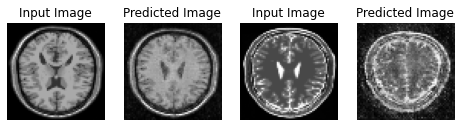

Saving checkpoint for epoch 188 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-188
Training Epoch:  189
gen_t1_loss: 7.764188766479492, gen_t2_loss: 7.764188766479492


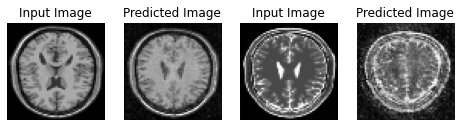

Saving checkpoint for epoch 189 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-189
Training Epoch:  190
gen_t1_loss: 7.018348852793376, gen_t2_loss: 7.018348852793376


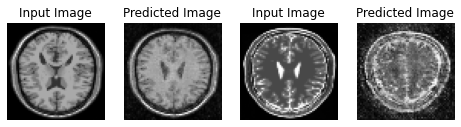

Saving checkpoint for epoch 190 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-190
Training Epoch:  191
gen_t1_loss: 7.445969343185425, gen_t2_loss: 7.445969343185425


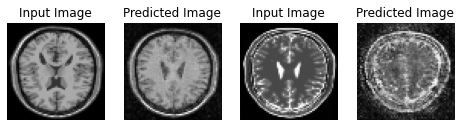

Saving checkpoint for epoch 191 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-191
Training Epoch:  192
gen_t1_loss: 7.060426791508992, gen_t2_loss: 7.060426791508992


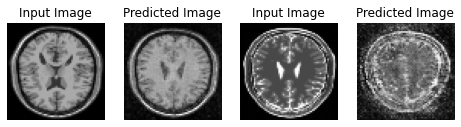

Saving checkpoint for epoch 192 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-192
Training Epoch:  193
gen_t1_loss: 8.645277897516886, gen_t2_loss: 8.645277897516886


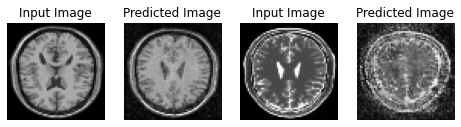

Saving checkpoint for epoch 193 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-193
Training Epoch:  194
gen_t1_loss: 13.696401397387186, gen_t2_loss: 13.696401397387186


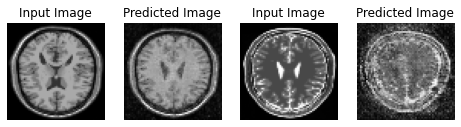

Saving checkpoint for epoch 194 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-194
Training Epoch:  195
gen_t1_loss: 44.5592180788517, gen_t2_loss: 44.5592180788517


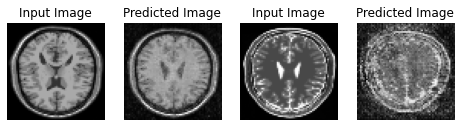

Saving checkpoint for epoch 195 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-195
Training Epoch:  196
gen_t1_loss: 47.4732500910759, gen_t2_loss: 47.4732500910759


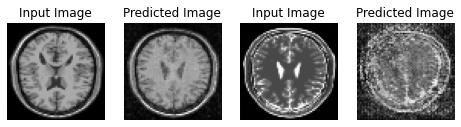

Saving checkpoint for epoch 196 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-196
Training Epoch:  197
gen_t1_loss: 34.98947538932165, gen_t2_loss: 34.98947538932165


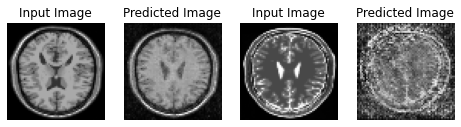

Saving checkpoint for epoch 197 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-197
Training Epoch:  198
gen_t1_loss: 35.29626051584879, gen_t2_loss: 35.29626051584879


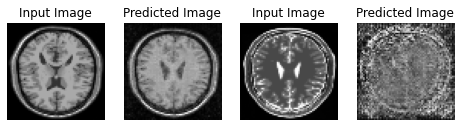

Saving checkpoint for epoch 198 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-198
Training Epoch:  199
gen_t1_loss: 29.39179899295171, gen_t2_loss: 29.39179899295171


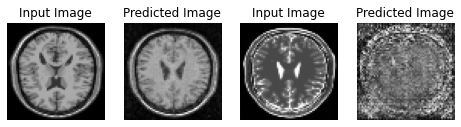

Saving checkpoint for epoch 199 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-199
Training Epoch:  200
gen_t1_loss: 31.534849325815838, gen_t2_loss: 31.534849325815838


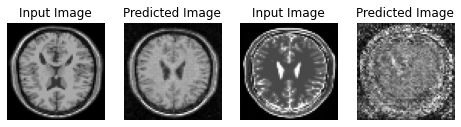

Saving checkpoint for epoch 200 at /Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/ckpt-200


In [159]:
min_loss = 0.0
min_loss_epoch = 0
patience = 5
generator_t1_loss = []
generator_t2_loss = []
for epoch in range(1, EPOCHS+1):
    print('Training Epoch: ', epoch)
    total_gen_t1_loss = []
    total_gen_t2_loss = []
    for t1_image, t2_image in zip(Tr1_dataset, Tr2_dataset):
        loss_gen_t1, loss_gen_t2 = train_step(t1_image, t2_image)
        total_gen_t1_loss.append(loss_gen_t1.numpy())
        total_gen_t2_loss.append(loss_gen_t2.numpy())
        
    generator_t1_loss.append(sum(total_gen_t1_loss)/len(total_gen_t1_loss))
    generator_t2_loss.append(sum(total_gen_t1_loss)/len(total_gen_t1_loss))
    print('gen_t1_loss: {}, gen_t2_loss: {}'.format(generator_t1_loss[-1], generator_t2_loss[-1]))
    generate_images(generator_t1, sample_t1_data, generator_t2, sample_t2_data)
    ckpt_save_path = ckpt_manager.save()
    print('Saving checkpoint for epoch', epoch, 'at', ckpt_save_path)
    
    #applying custom Early Stopping callback 
    if len(generator_t1_loss)>1:
        if generator_t1_loss[-1] < generator_t1_loss[-2]:
            min_loss = generator_t1_loss[-1]
            min_loss_epoch = epoch
            
    if min_loss_epoch+patience < epoch:
        print('Stoping training at epoch: {} as there is no improvment'.format(epoch))
        break

In [129]:
import imageio

In [130]:
anim_file = 'cyclegan.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
  filenames = glob.glob('/Users/nilanjansahu/Downloads/MRI Dataset/Trained_Model/image*.png')
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)


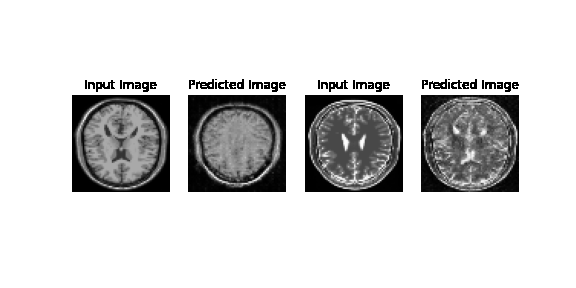

In [117]:
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[]

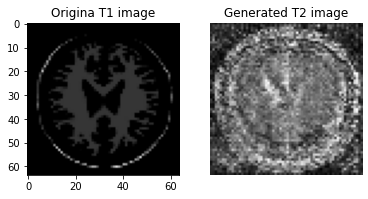

In [184]:
to_t2 = generator_t2(sample_t1_data)

plt.subplot(1,2,1)
plt.imshow(sample_t1_data[2].numpy(), cmap='gray')
plt.title('Origina T1 image')
plt.subplot(1,2,2)
plt.imshow(to_t2[2].numpy()[:,:,0]*127.5+127.5, cmap='gray')
plt.title('Generated T2 image')
plt.axis('off')
plt.plot()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[]

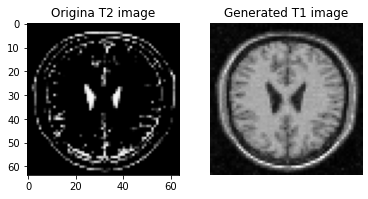

In [182]:
to_t1 = generator_t1(sample_t2_data)

plt.subplot(1,2,1)
plt.imshow(sample_t2_data[6].numpy(), cmap='gray')
plt.title('Origina T2 image')
plt.subplot(1,2,2)
plt.imshow(to_t1[6].numpy()[:,:,0]*127.5+127.5, cmap='gray')
plt.title('Generated T1 image')
plt.axis('off')
plt.plot()